Animation size has reached 21011919 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


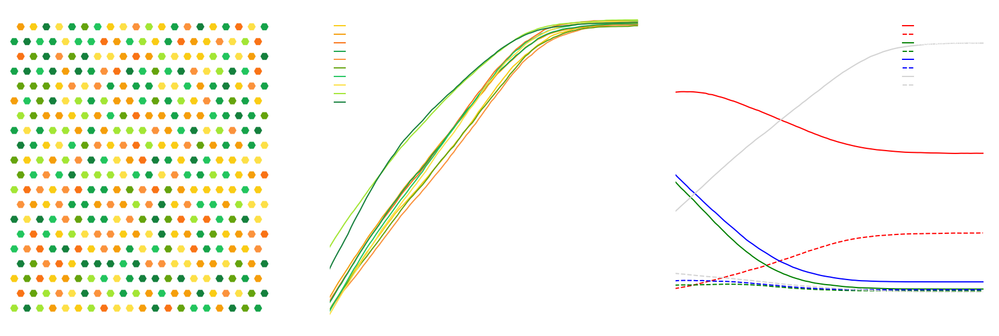

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors, animation
from matplotlib.collections import PolyCollection
from IPython.display import HTML


plt.rcParams.update({
    # Fondo transparente
    "figure.facecolor": (0,0,0,0),
    "axes.facecolor": (0,0,0,0),
    "savefig.transparent": True,

    "text.color": "white",
    "axes.labelcolor": "white",
    "axes.edgecolor": "white",
    "xtick.color": "white",
    "ytick.color": "white",

    "axes.grid": True,
    "grid.color": "white",
    "grid.alpha": 0.2,
    "grid.linestyle": "--",
    "legend.frameon": False,
})

PALETTE = {
    "AG_SAL": "#F59E0B", # Agave salmiana
    "OP_ROB": "#22C55E", # Opuntia robusta
    "OP_STR": "#FDE047", # Opuntia streptacantha
    "OP_ENG": "#65A30D", # Opuntia engelmannii
    "OP_CAN": "#FB923C", # Opuntia cantabrigiensis
    "PR_LAE": "#A3E635", # Prosopis laevigata
    "AG_LEC": "#FACC15", # Agave lechuguilla
    "AG_STR": "#16A34A", # Agave striata
    "AG_SCB": "#F97316", # Agave scabra
    "YU_FIL": "#15803D"  # Yucca filifera
}

SPECIES_TO_KEY = {
    "Agave salmiana": "AG_SAL",
    "Opuntia robusta": "OP_ROB",
    "Opuntia streptacantha": "OP_STR",
    "Opuntia engelmannii": "OP_ENG",
    "Opuntia cantabrigiensis": "OP_CAN",
    "Prosopis laevigata": "PR_LAE",
    "Agave lechuguilla": "AG_LEC",
    "Agave striata": "AG_STR",
    "Agave scabra": "AG_SCB",
    "Yucca filifera": "YU_FIL"
}

def get_color(sp_name):
    key = SPECIES_TO_KEY.get(sp_name)
    return PALETTE.get(key, "#9CA3AF") 


GRID_SIZE = 20
STEPS = 100
NEIGHBORHOOD = 1
LEARNING_RATE = 0.1

species_names = [
    "Agave lechuguilla", "Agave salmiana", "Agave scabra", "Agave striata",
    "Opuntia cantabrigiensis", "Opuntia engelmannii", "Opuntia robusta",
    "Opuntia streptacantha", "Prosopis laevigata", "Yucca filifera"
]
n_species = len(species_names)


species_traits = {
    "Agave lechuguilla": {"water_uptake_eff":0.75, "allelopathy_aggr":0.6, "allelopathy_susc":0.3, "nurse_effect":0.15},
    "Agave salmiana": {"water_uptake_eff":0.7, "allelopathy_aggr":0.4, "allelopathy_susc":0.4, "nurse_effect":0.25},
    "Agave scabra": {"water_uptake_eff":0.65, "allelopathy_aggr":0.5, "allelopathy_susc":0.35, "nurse_effect":0.15},
    "Agave striata": {"water_uptake_eff":0.7, "allelopathy_aggr":0.45, "allelopathy_susc":0.4, "nurse_effect":0.2},
    "Opuntia cantabrigiensis": {"water_uptake_eff":0.95, "allelopathy_aggr":0.3, "allelopathy_susc":0.8, "nurse_effect":0.1},
    "Opuntia engelmannii": {"water_uptake_eff":0.9, "allelopathy_aggr":0.35, "allelopathy_susc":0.75, "nurse_effect":0.15},
    "Opuntia robusta": {"water_uptake_eff":0.85, "allelopathy_aggr":0.4, "allelopathy_susc":0.7, "nurse_effect":0.2},
    "Opuntia streptacantha": {"water_uptake_eff":0.8, "allelopathy_aggr":0.45, "allelopathy_susc":0.65, "nurse_effect":0.2},
    "Prosopis laevigata": {"water_uptake_eff":1.0, "allelopathy_aggr":0.9, "allelopathy_susc":0.1, "nurse_effect":1.0},
    "Yucca filifera": {"water_uptake_eff":0.75, "allelopathy_aggr":0.3, "allelopathy_susc":0.4, "nurse_effect":0.7}
}
n_traits = 4
trait_names = ["Water Uptake Eff", "Allelopathy Aggr", "Allelopathy Susc", "Nurse Effect"]

weights = {"water_uptake_eff":1.0, "allelopathy_aggr":1.0, "allelopathy_susc":1.0, "nurse_effect":1.0}

def competition_cost_vec(xi, xj):
    water_diff = abs(xi[0] - xj[0])
    cost_water = weights["water_uptake_eff"] * (1 - water_diff) 
    
    allelo_cost_ij = xi[1] * xj[2]
    allelo_cost_ji = xj[1] * xi[2]
    cost_allelo = weights["allelopathy_aggr"] * (allelo_cost_ij + allelo_cost_ji)
    
    benefit_nurse_i = xi[3] * xj[3] 
    benefit_nurse_j = xj[3] * xi[3]
    benefit_nurse = weights["nurse_effect"] * (benefit_nurse_i + benefit_nurse_j)
    
    return (cost_water + cost_allelo) - benefit_nurse

grid_species = np.random.randint(0, n_species, size=(GRID_SIZE, GRID_SIZE))
grid_strategy = np.zeros((GRID_SIZE, GRID_SIZE, n_traits))
for i in range(GRID_SIZE):
    for j in range(GRID_SIZE):
        s_name = species_names[grid_species[i,j]]
        grid_strategy[i,j,:] = [species_traits[s_name]["water_uptake_eff"],
                                 species_traits[s_name]["allelopathy_aggr"],
                                 species_traits[s_name]["allelopathy_susc"],
                                 species_traits[s_name]["nurse_effect"]]


def get_neighbors(i, j, grid, radius=1):
    n = grid.shape[0]
    neighbors = []
    
    if i % 2 == 0: 
        deltas = [(0, -1), (0, 1), (-1, 0), (1, 0), (-1, -1), (1, -1)]
    else: 
        deltas = [(0, -1), (0, 1), (-1, 0), (1, 0), (-1, 1), (1, 1)]

    for di, dj in deltas:
        ni, nj = (i + di) % n, (j + dj) % n
        if di != 0 or dj != 0: 
            neighbors.append((ni, nj))
    return neighbors

def fitness_local_strategy(grid_strategy, i,j):
    xi = grid_strategy[i,j,:]
    neighbors = get_neighbors(i,j,grid_strategy[:,:,0])
    fit = 0
    for nx,ny in neighbors:
        xj = grid_strategy[nx,ny,:]
        fit -= competition_cost_vec(xi,xj)
    fit += xi[0] 
    return fit


def step_nash(grid_strategy):
    new_strategy = grid_strategy.copy()
    for i in range(GRID_SIZE):
        for j in range(GRID_SIZE):
            xi = grid_strategy[i,j,:]
            f_current = fitness_local_strategy(grid_strategy, i,j)
            
            for k in range(n_traits):
                xi_test = xi.copy()
                xi_test[k] = np.clip(xi_test[k] + (np.random.rand()-0.5)*LEARNING_RATE, 0, 1)
                
                temp_grid_strategy = grid_strategy.copy()
                temp_grid_strategy[i, j, k] = xi_test[k]
                
                f_test = fitness_local_strategy(temp_grid_strategy, i,j)
                
                if f_test > f_current:
                    new_strategy[i,j,k] = xi_test[k]
    return new_strategy


def hexagon_verts():
    angle = np.linspace(0, 2*np.pi, 7)[:-1]
    return np.array([np.cos(angle), np.sin(angle)]).T

def generate_hex_mesh(n):
    verts = []
    centers = []
    w = 0.5 
    s = np.sqrt(3) * w 
    
    for i in range(n):
        for j in range(n):
            x_center = j * (w * 3)
            y_center = i * s * 2
            
            if i % 2 == 1:
                x_center += w * 1.5
            
            centers.append((x_center, y_center))
            hex_shape = hexagon_verts() * w 
            verts.append(hex_shape + [x_center, y_center])
            
    return verts, centers


fig, (ax_grid, ax_fit, ax_traits) = plt.subplots(1, 3, figsize=(18, 6))

#  Grid 
verts, centers = generate_hex_mesh(GRID_SIZE)

species_color_list = [get_color(species_names[s_id]) for s_id in range(n_species)]
cmap_custom = colors.ListedColormap(species_color_list)
bounds = np.arange(-0.5, n_species + 0.5, 1)
norm = colors.BoundaryNorm(bounds, cmap_custom.N)

im = PolyCollection(verts, cmap=cmap_custom, norm=norm, edgecolors='white', linewidths=0.5)
im.set_array(grid_species.flatten()) 

ax_grid.add_collection(im)
ax_grid.set_xlim(min(c[0] for c in centers) - 1, max(c[0] for c in centers) + 1)
ax_grid.set_ylim(min(c[1] for c in centers) - 1, max(c[1] for c in centers) + 1)
ax_grid.set_aspect('equal')
ax_grid.set_title("Distribución espacial de especies (Hexagonal)")
ax_grid.axis("off")

# Fitness
lines_fit = []
fitness_history = np.full((STEPS, n_species), np.nan)
for s_id, s_name in enumerate(species_names):
    line_color = get_color(s_name)
    (line,) = ax_fit.plot([],[], label=s_name, color=line_color)
    lines_fit.append(line)

ax_fit.set_xlim(0,STEPS)
ax_fit.set_ylim(-7,12)
ax_fit.set_title("Fitness promedio por especie")
ax_fit.legend(fontsize="x-small", loc="upper left")


mean_history = np.full((STEPS, n_traits), np.nan)
var_history = np.full((STEPS, n_traits), np.nan)

lines_mean = []
lines_var = []
trait_colors = ['r', 'g', 'b', 'lightgray']

for t in range(n_traits):
    (line_m,) = ax_traits.plot([],[], color=trait_colors[t], linestyle='-', label=f"Mean {trait_names[t]}")
    lines_mean.append(line_m)
    
    (line_v,) = ax_traits.plot([],[], color=trait_colors[t], linestyle='--', label=f"Var {trait_names[t]}")
    lines_var.append(line_v)

ax_traits.set_xlim(0,STEPS)
ax_traits.set_ylim(-0.1, 1.1) 
ax_traits.set_title("Evolución de Rasgos (Promedio & Varianza)")
ax_traits.legend(fontsize="x-small", loc="upper right")

def init_anim():
    im.set_array(grid_species.flatten())
    
    for line in lines_fit:
        line.set_data([],[])
    for line in lines_mean + lines_var:
        line.set_data([],[])
    return [im] + lines_fit + lines_mean + lines_var

current_strategy = grid_strategy.copy()

def animate(t):
    global current_strategy
    
    current_strategy = step_nash(current_strategy)
    
    for s in range(n_species):
        indices = np.where(grid_species==s)
        if len(indices[0])>0:
            fitness_history[t,s] = np.mean([fitness_local_strategy(current_strategy,i,j)
                                             for i,j in zip(indices[0],indices[1])])
        else:
            fitness_history[t,s] = np.nan

    for k in range(n_traits):
        trait_values = current_strategy[:,:,k].flatten()
        mean_history[t, k] = np.mean(trait_values)
        var_history[t, k] = np.var(trait_values)

    im.set_array(grid_species.flatten()) 
    x = np.arange(0,t+1)
    
    for s,line in enumerate(lines_fit):
        line.set_data(x, fitness_history[:t+1,s])
    
    fit_min = np.nanmin(fitness_history[:t+1,:])
    fit_max = np.nanmax(fitness_history[:t+1,:])
    ax_fit.set_ylim(fit_min-0.1, fit_max+0.1)
    
    for k, line in enumerate(lines_mean):
        line.set_data(x, mean_history[:t+1, k])
        
    for k, line in enumerate(lines_var):
        line.set_data(x, var_history[:t+1, k])
        
    trait_max_val = np.nanmax(mean_history[:t+1,:])
    trait_var_max_val = np.nanmax(var_history[:t+1,:])
    
    ax_traits.set_ylim(-0.1, max(1.1, trait_max_val + 0.1, trait_var_max_val + 0.1))

    return [im] + lines_fit + lines_mean + lines_var

ani = animation.FuncAnimation(fig, animate, frames=STEPS, init_func=init_anim,
                                 blit=False, interval=1000, repeat=False)
plt.tight_layout()
HTML(ani.to_jshtml())

In [ ]:
import pandas as pd

species_strategy_init = np.array([list(species_traits[s].values()) for s in species_names])

competition_matrix = np.zeros((n_species, n_species))

for i in range(n_species):
    for j in range(n_species):
        
        cost_ij = competition_cost_vec(species_strategy_init[i], species_strategy_init[j])
        cost_ji = competition_cost_vec(species_strategy_init[j], species_strategy_init[i])
        competition_matrix[i,j] = (cost_ij + cost_ji) / 2

min_cost = competition_matrix.min()
max_cost = competition_matrix.max()

if max_cost == min_cost:
    competition_matrix_normalized = competition_matrix.copy()
    competition_matrix_normalized[:] = 1.0
else:
    competition_matrix_normalized = (competition_matrix - min_cost) / (max_cost - min_cost)

df_competition_normalized = pd.DataFrame(competition_matrix_normalized, 
                                         index=species_names, 
                                         columns=species_names)

print("Matriz de Costos de Competencia Inicial (Normalizada 0 a 1):")
df_competition_normalized

Matriz de Costos de Competencia Inicial (Normalizada 0 a 1):


,Agave lechuguilla,Agave salmiana,Agave scabra,Agave striata,Opuntia cantabrigiensis,Opuntia engelmannii,Opuntia robusta,Opuntia streptacantha,Prosopis laevigata,Yucca filifera
Agave lechuguilla,0.918280,0.883871,0.875269,0.896774,0.929032,0.937634,0.946237,0.961290,0.688172,0.834409
Agave salmiana,0.883871,0.866667,0.875269,0.886022,0.843011,0.853763,0.864516,0.886022,0.610753,0.731183
Agave scabra,0.875269,0.875269,0.913978,0.889247,0.858065,0.869892,0.881720,0.900000,0.660215,0.780645
Agave striata,0.896774,0.886022,0.889247,0.903226,0.864516,0.876344,0.888172,0.908602,0.655914,0.769892
Opuntia cantabrigiensis,0.929032,0.843011,0.858065,0.864516,0.980645,0.965591,0.950538,0.939785,0.997849,0.791398
Opuntia engelmannii,0.937634,0.853763,0.869892,0.876344,0.965591,0.989247,0.969892,0.956989,0.916129,0.784946
Opuntia robusta,0.946237,0.864516,0.881720,0.888172,0.950538,0.969892,0.989247,0.974194,0.834409,0.778495
Opuntia streptacantha,0.961290,0.886022,0.900000,0.908602,0.939785,0.956989,0.974194,1.000000,0.795699,0.802151
Prosopis laevigata,0.688172,0.610753,0.660215,0.655914,0.997849,0.916129,0.834409,0.795699,0.000000,0.240860
Yucca filifera,0.834409,0.731183,0.780645,0.769892,0.791398,0.784946,0.778495,0.802151,0.240860,0.464516


In [ ]:

df_competition_normalized = df_competition_normalized.rename(
    index=SPECIES_TO_KEY,
    columns=SPECIES_TO_KEY
)
df_competition_normalized.to_csv("w_matrix.csv")
